In [5]:
# Convertire un file SVG in un'immagine (PNG, ad esempio):
import cairosvg

svg_path = "R.svg"
output_png_path = "output_immagine.png"

# Converti SVG in PNG
cairosvg.svg2png(url=svg_path, write_to=output_png_path)


In [6]:
# Convertire immagine in svg
import sys
from PIL import Image
from potrace import Bitmap, POTRACE_TURNPOLICY_MINORITY  # `potracer` library


def file_to_svg(filename: str):
    try:

        image = Image.open(filename)
    except IOError:
        print("Image (%s) could not be loaded." % filename)
        return
    bm = Bitmap(image, blacklevel=0.5)
    # bm.invert()
    plist = bm.trace(
        turdsize=2,
        turnpolicy=POTRACE_TURNPOLICY_MINORITY,
        alphamax=1,
        opticurve=False,
        opttolerance=0.2,
    )
    with open(f"{filename}.svg", "w") as fp:
        fp.write(
            f'''<svg version="1.1" xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink" width="{image.width}" height="{image.height}" viewBox="0 0 {image.width} {image.height}">''')
        parts = []
        for curve in plist:
            fs = curve.start_point
            parts.append(f"M{fs.x},{fs.y}")
            for segment in curve.segments:
                if segment.is_corner:
                    a = segment.c
                    b = segment.end_point
                    parts.append(f"L{a.x},{a.y}L{b.x},{b.y}")
                else:
                    a = segment.c1
                    b = segment.c2
                    c = segment.end_point
                    parts.append(f"C{a.x},{a.y} {b.x},{b.y} {c.x},{c.y}")
            parts.append("z")
        fp.write(f'<path stroke="none" fill="black" fill-rule="evenodd" d="{"".join(parts)}"/>')
        fp.write("</svg>")

file_to_svg("test.jpg")

### Parametri

In [7]:
LEARNING_RATE = 0.0001#0.0002
BATCH_SIZE = 8#64
IMG_SIZE = "64x64"
EPOCHS = 138#380
LATENT_SIZE = 256#128
DESCRIPTION_STRUCT = "Simple"
NUM_FONTS = 2000
TRAINING_TIME = 0

### Prepara il dataset

In [49]:
import h5py
import matplotlib.pyplot as plt

file = h5py.File('fonts.hdf5', 'r')
dataset = file['fonts']
image_list = []
alfabeto = {i: chr(i + ord('A')) for i in range(26)}

selectedFont = [5, 8, 12, 22, 23, 25, 26, 47, 50, 54, 55, 56, 58, 59, 68, 69, 152, 155, 162, 167, 183, 193, 196, 197, 198, 199, 202, 212, 223, 226, 234, 259, 285, 319, 323, 324, 338, 339, 345, 347, 350, 351, 356, 359, 387, 389, 411, 427, 432, 454, 455, 501, 502, 615, 621, 629, 631, 638, 642, 644, 646, 654, 656, 660, 669, 682, 683, 686, 691, 693, 700, 718, 732, 749, 757, 780, 783, 789, 795, 803, 811, 816, 817, 825, 830, 836, 851, 854, 856, 860, 863, 867, 869, 872, 873, 876, 877, 878, 882, 910, 912, 919, 941, 943, 960, 962, 966, 971, 979, 980, 986, 994, 995, 1000, 1004, 1009, 1011, 1014, 1019, 1021, 1025, 1027, 1030, 1031, 1051, 1056, 1058, 1065, 1094, 1101, 1113, 1120, 1126, 1128, 1130, 1134, 1138, 1146, 1164, 1187, 1189, 1213, 1221, 1231, 1238, 1242, 1243, 1246, 1247, 1257, 1260, 1273, 1277, 1310, 1320, 1334, 1339, 1346, 1349, 1362, 1383, 1403, 1420, 1435, 1442, 1448]

# Itera attraverso gli elementi (font) nel dataset
for font_index, font in enumerate(dataset):
    if (font_index in selectedFont and font_index < 2000):
        for char_index, character_image in enumerate(font):
            if(char_index <=25):
                image_list.append(character_image)
                

NUM_IMAGES = len(image_list)
print(NUM_IMAGES)



166


In [11]:
from PIL import Image
import numpy as np
import os
import pandas as pd

df = pd.read_csv("FontScaricati/font_info.csv")
# df['Image Array'] = np.nan

image_list = []

for index, row in df.iterrows():
    font_file_path = row['Glyph']
    image_path = os.path.join('FontScaricati/', font_file_path)
    image = Image.open(image_path)
    # Estrai il canale alfa se l'immagine è RGBA
    if image.mode == 'RGBA':
        image = image.split()[3]
    # Converti in scala di grigi
    image = image.convert('L')
    # Ridimensiona l'immagine, funziona sicuro con 64x64
    resized_image = image.resize((128, 128))  # facciamolo fare a transform dopo no??? serve mo un poco sennò schiatta
    # Mostra l'immagine
#     plt.imshow(resized_image, cmap='gray')
#     plt.title(f'Immagine {index}')
#     plt.show()
    # Aggiungi l'immagine all'elenco
    image_array = np.array(resized_image)
    image_list.append(image_array)
    if(index > 140):
        break


# df['Image Array'] = image_list

In [12]:
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms

import os
import torchvision.transforms as tt
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
import torch.nn.functional as F
from torchvision.utils import save_image
from torchvision.utils import make_grid
import matplotlib.pyplot as plt



class CustomDataset(Dataset):
    def __init__(self, image_list, transform=None):
        self.data = image_list
        self.transform = transform

    def __len__(self):
        return len(self.data)
    

    def __getitem__(self, idx):
        # Carica l'immagine come array NumPy (o nel tuo caso, come oggetto immagine)
        image = self.data[idx]
        
        image = Image.fromarray(image.astype('uint8'))
        
        bbox = image.getbbox()
        image = image.crop(bbox)
        image = np.array(image)
    
        # Converte l'array NumPy o l'oggetto immagine in un tensore PyTorch
        if not torch.is_tensor(image):
            image = transforms.functional.to_pil_image(image)  # Converti in PIL Image

        # Applica le trasformazioni solo se sono fornite
        if self.transform:
            image = self.transform(image) 

        return image
    
    
transform = transforms.Compose([
    transforms.Pad(padding=6, fill=0, padding_mode='constant'),
    transforms.Resize((64, 64)),
    transforms.RandomRotation(degrees=20),
    #transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2), #forse si può togliere
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])  # Normalizzazione standard, aggiusta i valori in base ai tuoi dati
])

# transform = transforms.ToTensor()
custom_dataset = CustomDataset(image_list, transform=transform)

train_dl = DataLoader(custom_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=3, pin_memory=True)


### Visualizza la immagini di Training

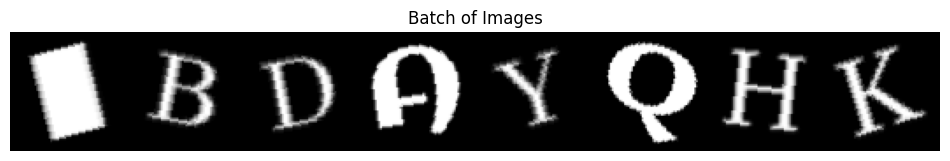

In [13]:
import matplotlib.pyplot as plt
import torchvision.utils as vutils

# Estrai un batch di dati dal DataLoader
for batch in train_dl:
    # Supponiamo che il batch contenga 'batch_size' immagini
    images = batch

    # Visualizza il batch di immagini
    plt.figure(figsize=(12, 12))
    plt.axis("off")
    plt.title("Batch of Images")
    plt.imshow(vutils.make_grid(images, nrow=8, padding=2, normalize=True).permute(1, 2, 0))
    plt.show()
    break  # Visualizza solo un batch e poi esci dal ciclo


### Configura la GPU

In [14]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)
    
device = get_default_device()
device

device(type='cuda')

In [15]:
train_dl = DeviceDataLoader(train_dl, device)

### Modelli

In [16]:
import torch.nn as nn

def load_or_create_model(model, model_path, device):
    if os.path.exists(model_path):
        model.load_state_dict(torch.load(model_path, map_location=device))
        print(f"Model loaded from {model_path}")
    else:
        model = to_device(model, device)
        print("New model created")
    return model


discriminator_path = "discriminator_google.pth"
generator_path = "generator_google.pth"

discriminator = nn.Sequential(
    # in: 1 x 64 x 64
    nn.Conv2d(1, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid())



generator = nn.Sequential(
    # in: latent_size x 1 x 1
    nn.ConvTranspose2d(LATENT_SIZE, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 1 x 64 x 64
)


# discriminator = nn.Sequential(
#     # in: 1 x 64 x 64

#     nn.Conv2d(1, 64, kernel_size=4, stride=2, padding=1, bias=False),
#     nn.BatchNorm2d(64),
#     nn.LeakyReLU(0.2, inplace=True),
#     # out: 64 x 32 x 32

#     nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
#     nn.BatchNorm2d(128),
#     nn.LeakyReLU(0.2, inplace=True),
#     # out: 128 x 16 x 16

#     nn.Conv2d(128, 1, kernel_size=16, stride=1, padding=0, bias=False),
#     # out: 1 x 1 x 1

#     nn.Flatten(),
#     nn.Sigmoid())

# generator = nn.Sequential(
#     # in: latent_size x 1 x 1

#     nn.ConvTranspose2d(LATENT_SIZE, 512, kernel_size=4, stride=1, padding=0, bias=False),
#     nn.BatchNorm2d(512),
#     nn.ReLU(True),
#     # out: 512 x 4 x 4

#     nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
#     nn.BatchNorm2d(256),
#     nn.ReLU(True),
#     # out: 256 x 8 x 8

#     nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
#     nn.BatchNorm2d(128),
#     nn.ReLU(True),
#     # out: 128 x 16 x 16

#     nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
#     nn.BatchNorm2d(64),
#     nn.ReLU(True),
#     # out: 64 x 32 x 32

#     nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1, bias=False),
#     nn.Tanh()
#     # out: 1 x 64 x 64
# )


discriminator = load_or_create_model(discriminator, discriminator_path, device)
generator = load_or_create_model(generator, generator_path, device)

Model loaded from discriminator_google.pth
Model loaded from generator_google.pth


In [18]:
# discriminator = to_device(discriminator, device)
# generator = to_device(generator, device)


In [17]:
xb = torch.randn(BATCH_SIZE, LATENT_SIZE, 1, 1).to('cuda')  # Sposta il tensore su GPU
print(xb.shape)
fake_images = generator(xb)
print(fake_images.shape)

plt.figure(figsize=(12, 12))
plt.axis("off")
plt.title("Batch of Images")
plt.imshow(vutils.make_grid(fake_images.cpu(), nrow=8, padding=2, normalize=True).permute(1, 2, 0).numpy())  # Sposta il tensore sull'host CPU per la visualizzazione
plt.show()


torch.Size([8, 256, 1, 1])


RuntimeError: Input type (torch.cuda.FloatTensor) and weight type (torch.FloatTensor) should be the same

### Training

In [21]:
def train_discriminator(real_images, opt_d):
    # Azzera i gradienti del discriminatore prima di calcolare i gradienti durante la retropropagazione.
    opt_d.zero_grad()

    # Passa le immagini reali attraverso il discriminatore.
    real_preds = discriminator(real_images)
    # Crea i target reali (etichette) che sono un vettore di 1.
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    # Calcola la loss per le immagini reali utilizzando la funzione di entropia binaria.
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    # Calcola il punteggio medio ottenuto dal discriminatore sulle immagini reali.
    real_score = torch.mean(real_preds).item()
    
    # Genera immagini fittizie (fake).
    latent = torch.randn(BATCH_SIZE, LATENT_SIZE, 1, 1, device=device) # Questa riga crea un tensore PyTorch con valori casuali 
    fake_images = generator(latent)

    # Passa le immagini fittizie attraverso il discriminatore.
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    # Calcola la loss per le immagini fittizie utilizzando la funzione di entropia binaria.
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    # Calcola il punteggio medio ottenuto dal discriminatore sulle immagini fittizie.
    fake_score = torch.mean(fake_preds).item()

    # Calcola la loss totale sommando le loss reali e fittizie.
    loss = real_loss + fake_loss
    # Esegue la retropropagazione della loss totale per aggiornare i pesi del discriminatore.
    loss.backward()
    opt_d.step()

    # Restituisce la loss totale, il punteggio medio sulle immagini reali e il punteggio medio sulle immagini fittizie.
    return loss.item(), real_score, fake_score



def train_generator(opt_g):
    # Azzera i gradienti del generatore prima di calcolare i gradienti durante la retropropagazione.
    opt_g.zero_grad()

    # Genera immagini fittizie (fake) utilizzando il generatore.
    latent = torch.randn(BATCH_SIZE, LATENT_SIZE, 1, 1, device=device)
    fake_images = generator(latent)

    # Cerca di ingannare il discriminatore facendogli credere che le immagini fittizie siano reali.
    preds = discriminator(fake_images)
    # Crea i target (etichette) che sono un vettore di 1, poiché l'obiettivo è far credere al discriminatore che le immagini sono reali.
    targets = torch.ones(BATCH_SIZE, 1, device=device)
    # Calcola la loss utilizzando la funzione di entropia binaria.
    loss = F.binary_cross_entropy(preds, targets)

    # Esegue la retropropagazione della loss per aggiornare i pesi del generatore.
    loss.backward()
    opt_g.step()

    # Restituisce il valore della loss.
    return loss.item()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0000.png


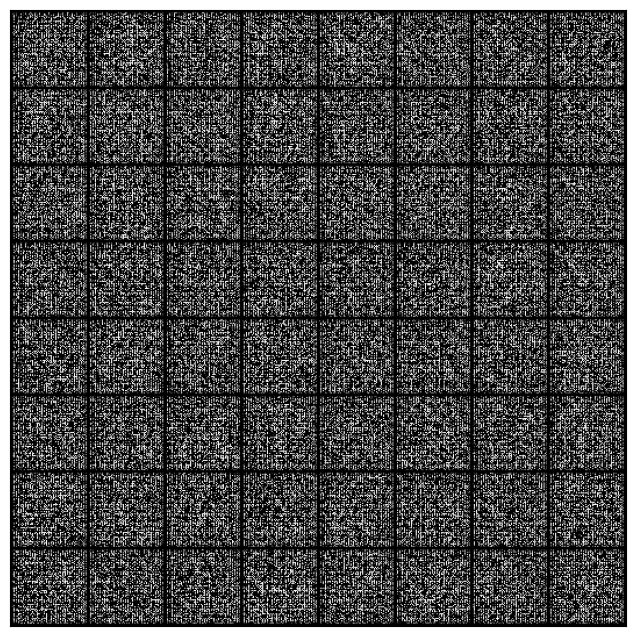

In [22]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

def save_samples(index, latent_tensors, show=True):
    print("shape latent tensors:", latent_tensors.shape)
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(fake_images, os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
        
fixed_latent = torch.randn(64, LATENT_SIZE, 1, 1).to('cuda')   

save_samples(0, fixed_latent)



In [23]:
import time


def fit(epochs, lr, start_idx=1):
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    
    start_time = time.time()

    for epoch in range(epochs):
        for real_images in tqdm(train_dl):
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            # Train generator
            loss_g = train_generator(opt_g)

            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # Save generated images
        save_samples(epoch+start_idx, fixed_latent, show=False)
   
    end_time = time.time()
    TRAINING_TIME = end_time - start_time

    return losses_g, losses_d, real_scores, fake_scores


history = fit(EPOCHS, LEARNING_RATE)

torch.save(discriminator.state_dict(), discriminator_path)
torch.save(generator.state_dict(), generator_path)

  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [1/138], loss_g: 5.2160, loss_d: 0.3769, real_score: 0.9984, fake_score: 0.2950
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0001.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [2/138], loss_g: 2.8625, loss_d: 1.2715, real_score: 0.6384, fake_score: 0.4004
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0002.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [3/138], loss_g: 1.1309, loss_d: 0.3779, real_score: 0.7545, fake_score: 0.0879
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0003.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [4/138], loss_g: 3.2755, loss_d: 0.2455, real_score: 0.9926, fake_score: 0.1754
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0004.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [5/138], loss_g: 2.7099, loss_d: 0.0363, real_score: 0.9981, fake_score: 0.0330
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0005.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [6/138], loss_g: 2.0913, loss_d: 0.1382, real_score: 0.9999, fake_score: 0.1159
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0006.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [7/138], loss_g: 1.9485, loss_d: 0.3147, real_score: 0.9968, fake_score: 0.2155
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0007.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [8/138], loss_g: 2.5699, loss_d: 0.1510, real_score: 0.9492, fake_score: 0.0924
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0008.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [9/138], loss_g: 4.0224, loss_d: 0.0291, real_score: 0.9989, fake_score: 0.0274
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0009.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [10/138], loss_g: 3.8855, loss_d: 0.0918, real_score: 0.9994, fake_score: 0.0716
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0010.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [11/138], loss_g: 2.0665, loss_d: 0.0360, real_score: 0.9761, fake_score: 0.0117
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0011.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [12/138], loss_g: 3.1182, loss_d: 0.0348, real_score: 0.9760, fake_score: 0.0105
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0012.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [13/138], loss_g: 0.8770, loss_d: 2.5344, real_score: 0.1155, fake_score: 0.0022
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0013.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [14/138], loss_g: 5.2054, loss_d: 0.1675, real_score: 0.8478, fake_score: 0.0023
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0014.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [15/138], loss_g: 3.0455, loss_d: 0.3596, real_score: 0.9881, fake_score: 0.2356
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0015.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [16/138], loss_g: 2.9809, loss_d: 0.0240, real_score: 0.9993, fake_score: 0.0230
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0016.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [17/138], loss_g: 3.4377, loss_d: 0.7603, real_score: 0.6069, fake_score: 0.0091
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0017.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [18/138], loss_g: 4.0008, loss_d: 0.0749, real_score: 0.9853, fake_score: 0.0555
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0018.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [19/138], loss_g: 2.9258, loss_d: 0.1035, real_score: 0.9918, fake_score: 0.0826
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0019.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [20/138], loss_g: 5.6464, loss_d: 0.0442, real_score: 0.9952, fake_score: 0.0341
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0020.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [21/138], loss_g: 2.9472, loss_d: 0.0240, real_score: 0.9978, fake_score: 0.0213
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0021.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [22/138], loss_g: 5.1730, loss_d: 0.0353, real_score: 0.9954, fake_score: 0.0297
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0022.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [23/138], loss_g: 2.2811, loss_d: 0.0117, real_score: 0.9981, fake_score: 0.0097
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0023.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [24/138], loss_g: 5.9072, loss_d: 0.2436, real_score: 0.8458, fake_score: 0.0539
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0024.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [25/138], loss_g: 4.9983, loss_d: 0.1613, real_score: 0.9741, fake_score: 0.1086
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0025.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [26/138], loss_g: 9.0699, loss_d: 0.0244, real_score: 0.9858, fake_score: 0.0099
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0026.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [27/138], loss_g: 2.0766, loss_d: 0.2209, real_score: 0.8057, fake_score: 0.0028
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0027.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [28/138], loss_g: 4.8324, loss_d: 0.0093, real_score: 0.9954, fake_score: 0.0047
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0028.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [29/138], loss_g: 5.8621, loss_d: 0.9090, real_score: 0.9988, fake_score: 0.4704
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0029.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [30/138], loss_g: 6.0988, loss_d: 0.2736, real_score: 0.8098, fake_score: 0.0550
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0030.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [31/138], loss_g: 4.3261, loss_d: 0.0306, real_score: 0.9993, fake_score: 0.0289
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0031.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [32/138], loss_g: 5.4800, loss_d: 0.2227, real_score: 0.8130, fake_score: 0.0017
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0032.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [33/138], loss_g: 4.5441, loss_d: 0.0056, real_score: 0.9985, fake_score: 0.0041
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0033.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [34/138], loss_g: 5.2481, loss_d: 0.0033, real_score: 0.9970, fake_score: 0.0004
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0034.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [35/138], loss_g: 2.4050, loss_d: 0.1865, real_score: 0.8780, fake_score: 0.0456
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0035.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [36/138], loss_g: 1.6053, loss_d: 0.3195, real_score: 0.7617, fake_score: 0.0007
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0036.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [37/138], loss_g: 5.8947, loss_d: 0.0219, real_score: 0.9984, fake_score: 0.0196
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0037.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [38/138], loss_g: 0.8458, loss_d: 4.6449, real_score: 0.0144, fake_score: 0.0863
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0038.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [39/138], loss_g: 3.1380, loss_d: 0.7628, real_score: 0.5692, fake_score: 0.0016
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0039.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [40/138], loss_g: 7.4248, loss_d: 0.1267, real_score: 0.8840, fake_score: 0.0015
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0040.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [41/138], loss_g: 6.7583, loss_d: 0.0213, real_score: 0.9995, fake_score: 0.0203
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0041.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [42/138], loss_g: 1.0380, loss_d: 4.2109, real_score: 0.0296, fake_score: 0.0046
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0042.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [43/138], loss_g: 10.5549, loss_d: 0.0112, real_score: 0.9998, fake_score: 0.0108
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0043.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [44/138], loss_g: 5.0904, loss_d: 0.5711, real_score: 0.5768, fake_score: 0.0120
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0044.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [45/138], loss_g: 9.7260, loss_d: 0.1091, real_score: 1.0000, fake_score: 0.0931
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0045.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [46/138], loss_g: 4.1500, loss_d: 0.0049, real_score: 0.9998, fake_score: 0.0046
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0046.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [47/138], loss_g: 1.9142, loss_d: 0.5661, real_score: 0.6315, fake_score: 0.0345
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0047.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [48/138], loss_g: 7.4906, loss_d: 0.4860, real_score: 0.6916, fake_score: 0.0065
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0048.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [49/138], loss_g: 3.2597, loss_d: 0.1018, real_score: 0.9055, fake_score: 0.0012
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0049.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [50/138], loss_g: 2.0762, loss_d: 3.6032, real_score: 0.0391, fake_score: 0.0005
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0050.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [51/138], loss_g: 5.5175, loss_d: 0.0126, real_score: 0.9993, fake_score: 0.0118
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0051.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [52/138], loss_g: 5.2820, loss_d: 0.0782, real_score: 0.9572, fake_score: 0.0315
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0052.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [53/138], loss_g: 6.6861, loss_d: 0.0252, real_score: 1.0000, fake_score: 0.0247
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0053.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [54/138], loss_g: 8.5573, loss_d: 0.0273, real_score: 0.9734, fake_score: 0.0002
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0054.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [55/138], loss_g: 6.4654, loss_d: 0.0293, real_score: 0.9871, fake_score: 0.0160
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0055.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [56/138], loss_g: 8.2822, loss_d: 0.0081, real_score: 1.0000, fake_score: 0.0080
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0056.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [57/138], loss_g: 8.4784, loss_d: 0.1750, real_score: 1.0000, fake_score: 0.1314
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0057.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [58/138], loss_g: 8.6603, loss_d: 0.0770, real_score: 0.9267, fake_score: 0.0002
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0058.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [59/138], loss_g: 1.0685, loss_d: 0.0019, real_score: 0.9999, fake_score: 0.0018
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0059.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [60/138], loss_g: 12.5895, loss_d: 0.1262, real_score: 0.9953, fake_score: 0.1069
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0060.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [61/138], loss_g: 7.4326, loss_d: 0.0127, real_score: 0.9999, fake_score: 0.0122
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0061.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [62/138], loss_g: 7.2842, loss_d: 0.0913, real_score: 0.9157, fake_score: 0.0022
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0062.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [63/138], loss_g: 4.2436, loss_d: 0.4535, real_score: 0.6977, fake_score: 0.0044
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0063.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [64/138], loss_g: 9.2080, loss_d: 0.0007, real_score: 1.0000, fake_score: 0.0007
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0064.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [65/138], loss_g: 7.0350, loss_d: 0.0075, real_score: 0.9940, fake_score: 0.0015
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0065.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [66/138], loss_g: 2.9256, loss_d: 5.9043, real_score: 0.0028, fake_score: 0.0008
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0066.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [67/138], loss_g: 2.4370, loss_d: 6.8876, real_score: 0.0051, fake_score: 0.0028
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0067.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [68/138], loss_g: 7.7454, loss_d: 0.0160, real_score: 0.9999, fake_score: 0.0156
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0068.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [69/138], loss_g: 8.2060, loss_d: 0.1341, real_score: 0.9022, fake_score: 0.0286
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0069.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [70/138], loss_g: 4.8984, loss_d: 0.0680, real_score: 0.9382, fake_score: 0.0020
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0070.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [71/138], loss_g: 8.8887, loss_d: 0.0001, real_score: 1.0000, fake_score: 0.0001
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0071.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [72/138], loss_g: 7.4903, loss_d: 0.0024, real_score: 0.9982, fake_score: 0.0006
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0072.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [73/138], loss_g: 9.8236, loss_d: 0.0005, real_score: 1.0000, fake_score: 0.0005
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0073.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [74/138], loss_g: 7.9021, loss_d: 0.1257, real_score: 0.9999, fake_score: 0.1061
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0074.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [75/138], loss_g: 8.4459, loss_d: 0.0608, real_score: 0.9423, fake_score: 0.0005
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0075.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [76/138], loss_g: 6.3026, loss_d: 0.7124, real_score: 0.5342, fake_score: 0.0082
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0076.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [77/138], loss_g: 2.5323, loss_d: 4.3218, real_score: 0.0201, fake_score: 0.0041
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0077.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [78/138], loss_g: 6.2488, loss_d: 0.4590, real_score: 0.6975, fake_score: 0.0264
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0078.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [79/138], loss_g: 4.0502, loss_d: 0.0245, real_score: 0.9768, fake_score: 0.0007
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0079.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [80/138], loss_g: 10.4733, loss_d: 0.0876, real_score: 0.9206, fake_score: 0.0027
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0080.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [81/138], loss_g: 4.8147, loss_d: 0.0004, real_score: 1.0000, fake_score: 0.0004
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0081.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [82/138], loss_g: 7.3644, loss_d: 0.2202, real_score: 0.8111, fake_score: 0.0001
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0082.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [83/138], loss_g: 3.0130, loss_d: 0.0422, real_score: 1.0000, fake_score: 0.0392
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0083.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [84/138], loss_g: 5.9465, loss_d: 0.0013, real_score: 0.9996, fake_score: 0.0009
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0084.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [85/138], loss_g: 6.7681, loss_d: 0.1052, real_score: 0.9999, fake_score: 0.0922
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0085.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [86/138], loss_g: 5.2891, loss_d: 0.0321, real_score: 0.9746, fake_score: 0.0061
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0086.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [87/138], loss_g: 1.1539, loss_d: 2.6958, real_score: 0.2866, fake_score: 0.0094
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0087.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [88/138], loss_g: 6.1724, loss_d: 0.0008, real_score: 1.0000, fake_score: 0.0008
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0088.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [89/138], loss_g: 6.0819, loss_d: 0.0504, real_score: 0.9569, fake_score: 0.0062
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0089.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [90/138], loss_g: 10.0410, loss_d: 0.0013, real_score: 1.0000, fake_score: 0.0013
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0090.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [91/138], loss_g: 9.0702, loss_d: 0.2011, real_score: 0.8317, fake_score: 0.0019
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0091.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [92/138], loss_g: 6.1929, loss_d: 0.0110, real_score: 0.9965, fake_score: 0.0075
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0092.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [93/138], loss_g: 6.9784, loss_d: 0.0289, real_score: 0.9719, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0093.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [94/138], loss_g: 5.9662, loss_d: 0.0280, real_score: 0.9728, fake_score: 0.0001
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0094.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [95/138], loss_g: 8.6359, loss_d: 0.0000, real_score: 1.0000, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0095.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [96/138], loss_g: 10.4610, loss_d: 0.0004, real_score: 0.9996, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0096.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [97/138], loss_g: 5.4751, loss_d: 0.0002, real_score: 1.0000, fake_score: 0.0002
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0097.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [98/138], loss_g: 0.2574, loss_d: 5.6306, real_score: 0.0057, fake_score: 0.0002
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0098.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [99/138], loss_g: 5.6023, loss_d: 0.0373, real_score: 0.9666, fake_score: 0.0033
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0099.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [100/138], loss_g: 10.3275, loss_d: 0.0363, real_score: 0.9659, fake_score: 0.0010
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0100.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [101/138], loss_g: 11.3765, loss_d: 0.0002, real_score: 1.0000, fake_score: 0.0002
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0101.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [102/138], loss_g: 1.6362, loss_d: 6.6162, real_score: 0.0018, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0102.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [103/138], loss_g: 12.1203, loss_d: 0.0015, real_score: 0.9990, fake_score: 0.0004
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0103.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [104/138], loss_g: 2.4795, loss_d: 0.4838, real_score: 0.6638, fake_score: 0.0082
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0104.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [105/138], loss_g: 2.8383, loss_d: 5.1667, real_score: 0.0075, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0105.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [106/138], loss_g: 10.8272, loss_d: 0.0003, real_score: 0.9999, fake_score: 0.0003
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0106.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [107/138], loss_g: 8.4867, loss_d: 0.0001, real_score: 1.0000, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0107.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [108/138], loss_g: 8.5715, loss_d: 0.0339, real_score: 0.9671, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0108.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [109/138], loss_g: 10.2044, loss_d: 0.0346, real_score: 0.9682, fake_score: 0.0017
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0109.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [110/138], loss_g: 5.1041, loss_d: 1.0847, real_score: 0.3383, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0110.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [111/138], loss_g: 6.3234, loss_d: 0.8053, real_score: 0.5467, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0111.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [112/138], loss_g: 6.6715, loss_d: 0.0129, real_score: 1.0000, fake_score: 0.0127
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0112.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [113/138], loss_g: 7.9009, loss_d: 0.0033, real_score: 1.0000, fake_score: 0.0033
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0113.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [114/138], loss_g: 12.2711, loss_d: 0.0002, real_score: 1.0000, fake_score: 0.0002
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0114.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [115/138], loss_g: 7.2286, loss_d: 0.0072, real_score: 1.0000, fake_score: 0.0071
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0115.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [116/138], loss_g: 7.0548, loss_d: 0.0019, real_score: 1.0000, fake_score: 0.0018
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0116.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [117/138], loss_g: 7.8017, loss_d: 0.8196, real_score: 0.5895, fake_score: 0.0002
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0117.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [118/138], loss_g: 11.7878, loss_d: 0.0793, real_score: 0.9240, fake_score: 0.0001
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0118.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [119/138], loss_g: 5.5312, loss_d: 3.6501, real_score: 0.0271, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0119.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [120/138], loss_g: 7.2536, loss_d: 0.0022, real_score: 0.9999, fake_score: 0.0021
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0120.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [121/138], loss_g: 6.9164, loss_d: 0.8449, real_score: 0.5736, fake_score: 0.0029
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0121.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [122/138], loss_g: 7.5266, loss_d: 0.0045, real_score: 0.9963, fake_score: 0.0007
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0122.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [123/138], loss_g: 11.8295, loss_d: 0.0000, real_score: 1.0000, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0123.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [124/138], loss_g: 10.4504, loss_d: 0.0044, real_score: 0.9981, fake_score: 0.0025
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0124.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [125/138], loss_g: 0.4315, loss_d: 2.1258, real_score: 0.3549, fake_score: 0.0039
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0125.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [126/138], loss_g: 8.5695, loss_d: 0.1883, real_score: 0.8442, fake_score: 0.0016
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0126.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [127/138], loss_g: 1.8779, loss_d: 3.0683, real_score: 0.0868, fake_score: 0.0226
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0127.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [128/138], loss_g: 12.6075, loss_d: 0.0040, real_score: 0.9996, fake_score: 0.0036
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0128.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [129/138], loss_g: 8.9193, loss_d: 0.0888, real_score: 0.9988, fake_score: 0.0741
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0129.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [130/138], loss_g: 6.5383, loss_d: 0.0487, real_score: 0.9997, fake_score: 0.0461
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0130.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [131/138], loss_g: 4.1652, loss_d: 2.7730, real_score: 0.2929, fake_score: 0.0001
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0131.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [132/138], loss_g: 7.4044, loss_d: 0.0234, real_score: 0.9998, fake_score: 0.0213
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0132.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [133/138], loss_g: 11.7945, loss_d: 0.0000, real_score: 1.0000, fake_score: 0.0000
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0133.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [134/138], loss_g: 10.1925, loss_d: 0.0423, real_score: 1.0000, fake_score: 0.0402
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0134.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [135/138], loss_g: 12.0153, loss_d: 0.0017, real_score: 0.9999, fake_score: 0.0017
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0135.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [136/138], loss_g: 0.6204, loss_d: 3.7123, real_score: 0.0858, fake_score: 0.0002
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0136.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [137/138], loss_g: 7.6697, loss_d: 0.0015, real_score: 1.0000, fake_score: 0.0014
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0137.png


  0%|          | 0/1317 [00:00<?, ?it/s]

Epoch [138/138], loss_g: 8.3174, loss_d: 0.0001, real_score: 1.0000, fake_score: 0.0001
shape latent tensors: torch.Size([64, 256, 1, 1])
Saving generated-images-0138.png


In [24]:
# SAVE
torch.save(discriminator.state_dict(), discriminator_path)
torch.save(generator.state_dict(), generator_path)

### Valutazione


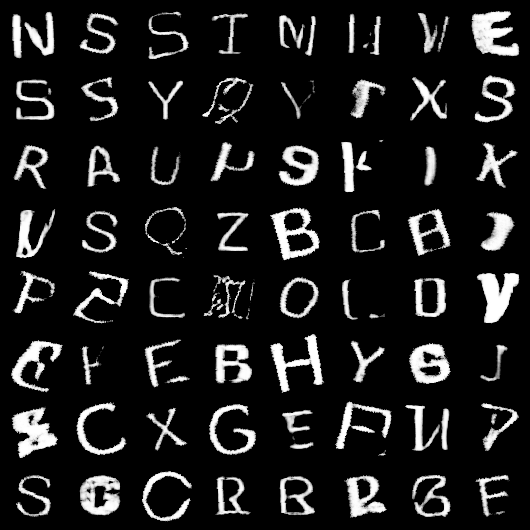

In [25]:
from IPython.display import Image

losses_g, losses_d, real_scores, fake_scores = history
file_path = f'./generated/generated-images-{EPOCHS:04d}.png'
Image(file_path)

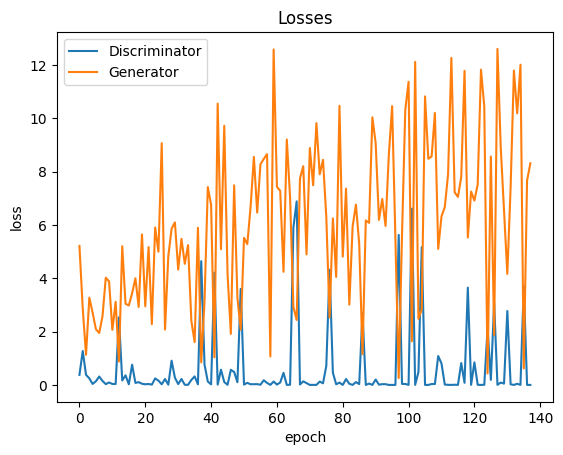

In [26]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

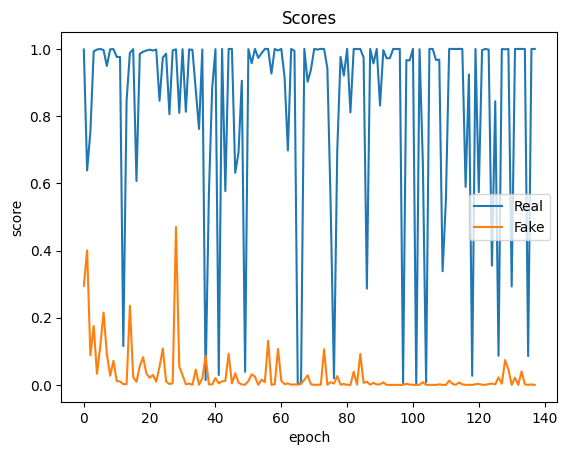

In [27]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

<class 'torch.Tensor'>
torch.Size([1, 64, 64])


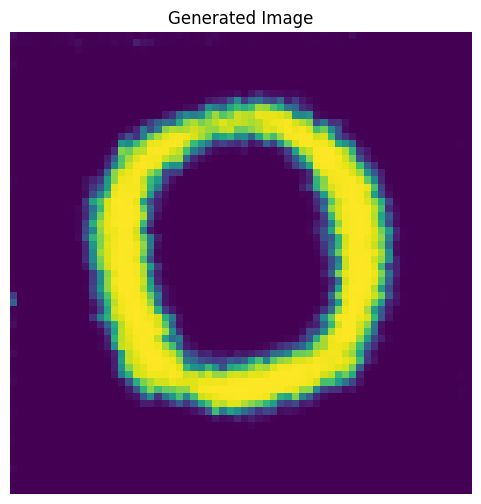

In [32]:
import torch
import matplotlib.pyplot as plt
from torchvision import utils as vutils
from PIL import Image,ImageOps
import numpy as np
from scipy.ndimage import median_filter

fileName = "outputGlyph"

# Assicurati che il generatore e i dati siano sulla GPU
# generator = generator.to('cuda')

xb = torch.randn(BATCH_SIZE, LATENT_SIZE, 1, 1).to('cuda')
fake_images = generator(xb)

# Seleziona la prima immagine dal batch
single_fake_image = fake_images[0]

print(type(single_fake_image))
print(single_fake_image.shape)

# Visualizza l'immagine
plt.figure(figsize=(6, 6))
plt.axis("off")
plt.title("Generated Image")
plt.imshow(single_fake_image.cpu().detach().permute(1, 2, 0).numpy())
plt.show()


# CONVERTILA IN PNG
# Trasferisci il tensore sulla CPU
tensor_image_cpu = single_fake_image.cpu()
# Converte il tensore in un array NumPy
numpy_image = tensor_image_cpu.mul(255).byte().numpy().squeeze()
original_image = Image.fromarray(numpy_image, mode='L')  # 'L' sta per scala di grigi

original_image = ImageOps.invert(original_image) # Inverti colori
original_image.save(fileName+".png")

# CONVERTILA IN SVG!
file_to_svg(fileName+".png")

In [33]:
# Applicazione di filtri:

from PIL import Image, ImageFilter, ImageOps

# ... (codice precedente)

# Applica un filtro gaussiano
gaussian_filtered_image = original_image.filter(ImageFilter.GaussianBlur(radius=2))

# Applica un filtro mediano
median_filtered_image = original_image.filter(ImageFilter.MedianFilter(size=3))

# Salva le immagini filtrate in formato PNG
gaussian_filtered_image.save(fileName+"_gaussian.png")
median_filtered_image.save(fileName+"_median.png")

# Conversione in svg
file_to_svg(fileName+"_gaussian.png")
file_to_svg(fileName+"_median.png")

### Traccia i risultati

In [18]:
import csv
from datetime import datetime

headers = [
    "LEARNING_RATE",
    "BATCH_SIZE",
    "IMG_SIZE",
    "EPOCHS",
    "LATENT_SIZE",
    "DESCRIPTION_STRUCT",
    "NUM_FONTS",
    'TRAINING_TIME'
    "DATE"
]


DATE = datetime.now().strftime("%Y-%m-%d %H:%M:%S")

with open('Results/outcome.csv', 'a', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(headers)
    writer.writerow([LEARNING_RATE, BATCH_SIZE, IMG_SIZE, EPOCHS, LATENT_SIZE, DESCRIPTION_STRUCT, NUM_FONTS,TRAINING_TIME,  DATE])

file.close()


NameError: name 'TRAINING_TIME' is not defined

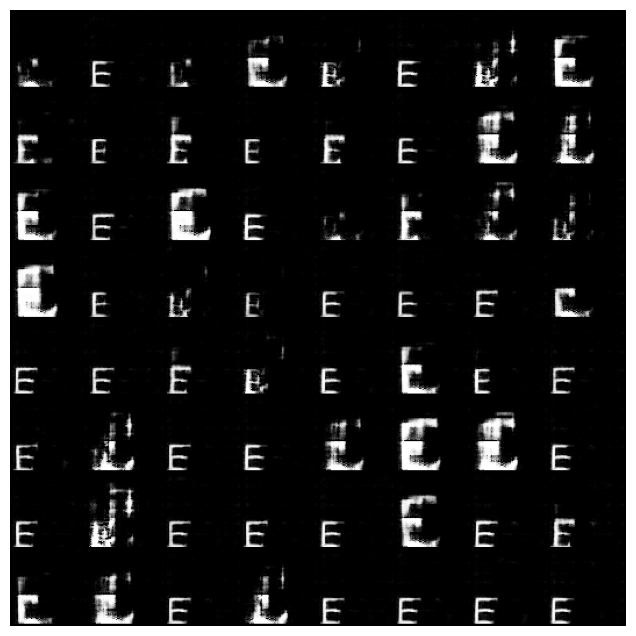

In [73]:
import matplotlib.animation as animation
from IPython.display import HTML
import matplotlib.pyplot as plt
from torchvision import transforms


from PIL import Image
import glob
import torch

image_folder = 'generated/'
img_list = []

max_frames = 60

for filename in glob.glob(image_folder + '/*.png')[:max_frames]:
    img = Image.open(filename)
    img = transforms.ToTensor()(img)  # Converte l'immagine in un tensore
    img_list.append(img)


fig = plt.figure(figsize=(10,8))
plt.axis("off")
ims = [[plt.imshow(i.permute(1,2,0), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

